# Analysis with Crisis-Zoom

This script conducts:
- Rolling Granger-Causality tests
- Generalized Impulse Response Functions
- Return Analysis
    - Overall Sector Return behavior depending on type of Oil
    - Extreme Value Theory and CVaR

with a focus on the different identified crises of interest in the dataset period

In [6]:
import pandas as pd
import numpy as np
from statsmodels.tsa.vector_ar.var_model import VAR
from statsmodels.tsa.stattools import grangercausalitytests
import matplotlib.pyplot as plt
import seaborn as sns

### Preparing Data

In [7]:
# load processed data
data = pd.read_csv('ProcessedData.csv')

# make Date the index
data['Date'] = pd.to_datetime(data['Date'])
data.set_index('Date', inplace=True)

In [8]:
# for now we will only use VIX Close, WTI Spot Price, IT Adj Close_Return, HC Adj Close_Return AND CD Adj Close_Return, IT Volume, HD Volume, CD Volume
data = data[['VIX Close', 'WTI Log Daily Change', 'IT_Log_Return', 'HC_Log_Return', 'CD_Log_Return', 'IT Volume', 'HC Volume', 'CD Volume']]
# rename VIX Close to VIX, IT Adj Close_Return to IT Daily Return, HC Adj Close_Return to HC Daily Return, CD Adj Close_Return to CD Daily Return
data.rename(columns={'VIX Close': 'VIX'})

,VIX,WTI Log Daily Change,IT_Log_Return,HC_Log_Return,CD_Log_Return,IT Volume,HC Volume,CD Volume
Date,,,,,,,,
1993-05-05,12.38,0.002937,0.008621,0.008757,-0.002610,0,0,0
1993-05-06,13.22,0.001465,-0.006131,-0.013274,-0.003120,0,0,0
1993-05-07,13.01,-0.002933,0.008729,-0.004760,-0.000605,0,0,0
1993-05-10,13.72,-0.000490,-0.000779,0.001220,0.005332,0,0,0
1993-05-11,13.35,-0.001961,-0.006381,0.002877,0.002706,0,0,0
...,...,...,...,...,...,...,...,...
2025-04-22,30.57,0.017490,0.024226,0.017848,0.031825,806867100,223050800,472384400
2025-04-23,28.45,-0.030810,0.028758,0.005340,0.027267,978415600,280000500,591385400
2025-04-24,26.47,0.014423,0.034781,0.012289,0.022318,938353200,254195200,431896300


In [9]:
# remame HC Daily Return to Health Care Daily Return, CD Daaily Return to Consumer Discretionary Daily Return, IT Daily Return to Information Technology Daily Return
data.rename(columns={'HC_Log_Return': 'Health Care Daily Log Return', 'CD_Log_Return': 'Consumer Discretionary Daily Log Return', 'IT_Log_Return': 'Information Technology Daily Log Return'}, inplace=True)

In [10]:
data

,VIX Close,WTI Log Daily Change,Information Technology Daily Log Return,Health Care Daily Log Return,Consumer Discretionary Daily Log Return,IT Volume,HC Volume,CD Volume
Date,,,,,,,,
1993-05-05,12.38,0.002937,0.008621,0.008757,-0.002610,0,0,0
1993-05-06,13.22,0.001465,-0.006131,-0.013274,-0.003120,0,0,0
1993-05-07,13.01,-0.002933,0.008729,-0.004760,-0.000605,0,0,0
1993-05-10,13.72,-0.000490,-0.000779,0.001220,0.005332,0,0,0
1993-05-11,13.35,-0.001961,-0.006381,0.002877,0.002706,0,0,0
...,...,...,...,...,...,...,...,...
2025-04-22,30.57,0.017490,0.024226,0.017848,0.031825,806867100,223050800,472384400
2025-04-23,28.45,-0.030810,0.028758,0.005340,0.027267,978415600,280000500,591385400
2025-04-24,26.47,0.014423,0.034781,0.012289,0.022318,938353200,254195200,431896300


## Rolling-Granger Causality

Decreasing Window Size for Crisis-Zoom in to better isolate immediate effects and dynamics

In [11]:
import pandas as pd
import numpy as np
from statsmodels.tsa.api import VAR
import matplotlib.pyplot as plt

# === SETTINGS ===
window_sizes = [252, 63, 21]     # Rolling windows (in trading days)
max_lag = 6                      # VAR lag length
sectors = [
    'Information Technology Daily Log Return',
    'Health Care Daily Log Return',
    'Consumer Discretionary Daily Log Return'
]

# === Ensure datetime index ===
data.index = pd.to_datetime(data.index)

# === Initialize storage dictionaries ===
rolling_joint_pvals = {}
rolling_oil_pvals = {}
rolling_vix_pvals = {}

# === MAIN LOOP ===
for window_size in window_sizes:
    print(f"Computing rolling Granger causality with window = {window_size}...")

    joint_pvals = {sector: [] for sector in sectors}
    oil_pvals = {sector: [] for sector in sectors}
    vix_pvals = {sector: [] for sector in sectors}
    rolling_dates = []

    for start in range(len(data) - window_size):
        end = start + window_size
        rolling_dates.append(data.index[end])
        window_data = data.iloc[start:end]

        for sector in sectors:
            try:
                temp_data = window_data[['WTI Log Daily Change', 'VIX Close', sector]].dropna()
                model = VAR(temp_data)
                fitted = model.fit(maxlags=max_lag, ic='aic')

                # Joint test: WTI + VIX
                joint_test = fitted.test_causality(causing=['WTI Log Daily Change', 'VIX Close'], caused=sector, kind='f')
                joint_pvals[sector].append(joint_test.pvalue)

                # WTI only (controlling for VIX)
                oil_test = fitted.test_causality(causing='WTI Log Daily Change', caused=sector, kind='f')
                oil_pvals[sector].append(oil_test.pvalue)

                # VIX only (controlling for WTI)
                vix_test = fitted.test_causality(causing='VIX Close', caused=sector, kind='f')
                vix_pvals[sector].append(vix_test.pvalue)

            except Exception as e:
                joint_pvals[sector].append(np.nan)
                oil_pvals[sector].append(np.nan)
                vix_pvals[sector].append(np.nan)

    # Convert to DataFrames
    rolling_joint_pvals[window_size] = pd.DataFrame(joint_pvals, index=rolling_dates)
    rolling_oil_pvals[window_size] = pd.DataFrame(oil_pvals, index=rolling_dates)
    rolling_vix_pvals[window_size] = pd.DataFrame(vix_pvals, index=rolling_dates)

print("✅ Finished computing all rolling Granger causality p-values.")


Computing rolling Granger causality with window = 252...


C:\Users\nicol\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\nicol\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\nicol\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g

Computing rolling Granger causality with window = 63...


C:\Users\nicol\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\nicol\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\nicol\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g

Computing rolling Granger causality with window = 21...


C:\Users\nicol\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\nicol\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\nicol\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g

✅ Finished computing all rolling Granger causality p-values.


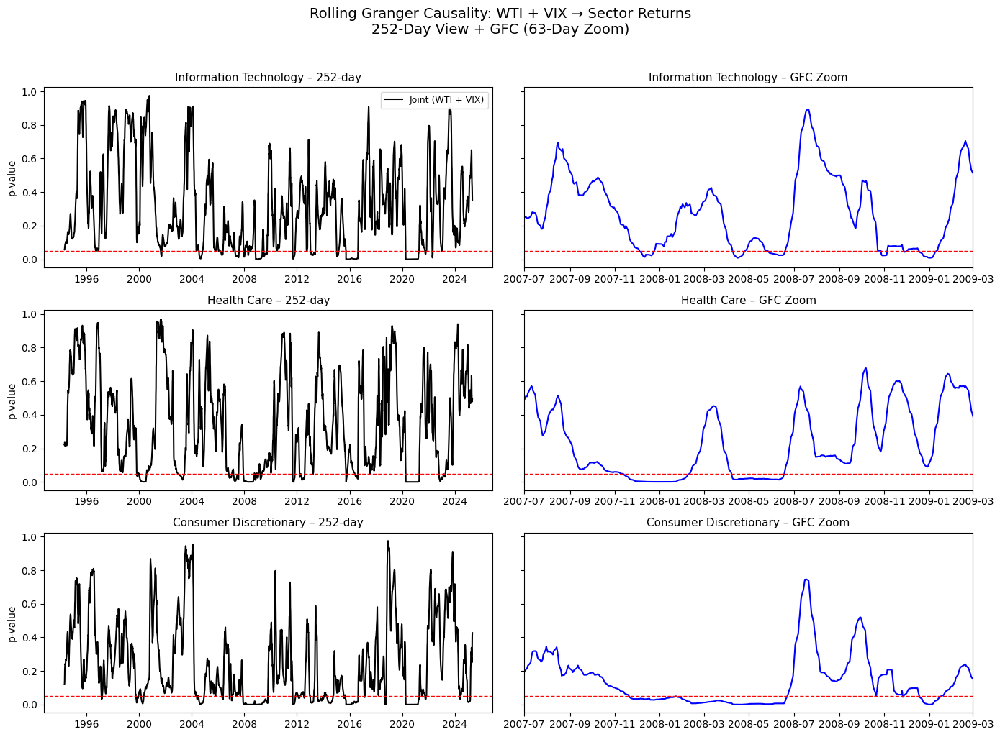

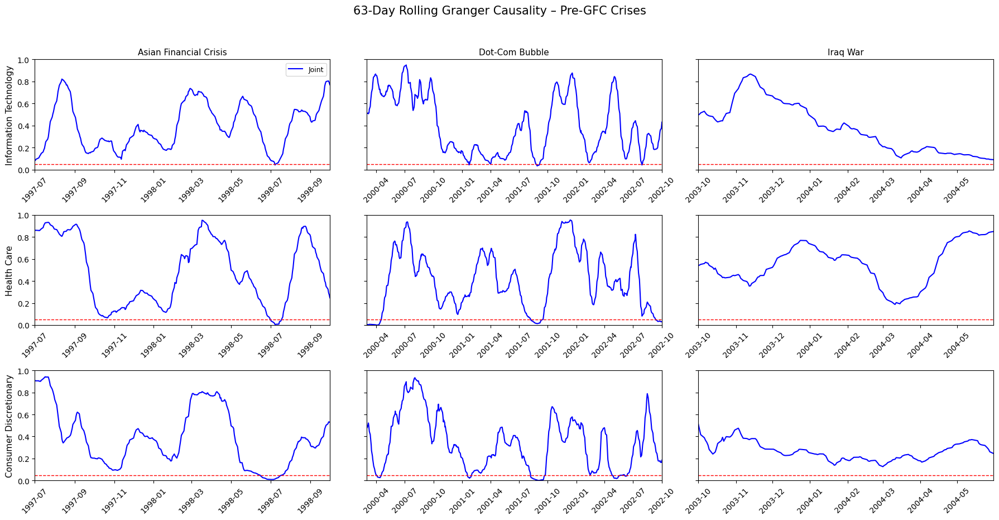

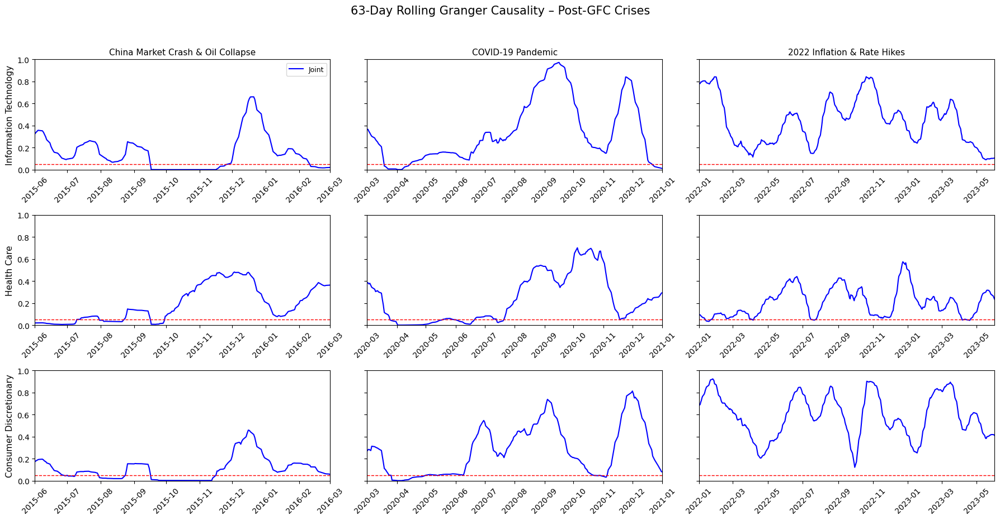

In [12]:
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import pandas as pd

# === Required Inputs ===
# Make sure `rolling_pvals_dict` is already computed with keys 252 and 63

# === Crisis windows ===
crisis_windows = [
    ("Asian Financial Crisis", "1997-07-01", "1998-10-01"),
    ("Dot-Com Bubble", "2000-03-01", "2002-10-01"),
    ("Iraq War", "2003-10-01", "2004-05-31"),
    ("Global Financial Crisis", "2007-07-01", "2009-03-01"),
    ("China Market Crash & Oil Collapse", "2015-06-01", "2016-03-01"),
    ("COVID-19 Pandemic", "2020-03-01", "2021-01-01"),
    ("2022 Inflation & Rate Hikes", "2022-01-01", "2023-06-01")
]

sectors = [
    'Information Technology Daily Log Return',
    'Health Care Daily Log Return',
    'Consumer Discretionary Daily Log Return'
]

# === Figure 1: 252-day full view + GFC zoom (63-day) ===
def plot_main_grid_gfc(rolling_pvals_dict, rolling_oil_pvals, rolling_vix_pvals, sectors):
    fig, axes = plt.subplots(len(sectors), 2, figsize=(14, 10), sharey=True)
    fig.subplots_adjust(hspace=0.4, wspace=0.25)
    crisis_start, crisis_end = pd.to_datetime("2007-07-01"), pd.to_datetime("2009-03-01")

    for i, sector in enumerate(sectors):
        # Full 252-day view
        ax = axes[i, 0]
        smoothed_joint = rolling_pvals_dict[252][sector].rolling(20, min_periods=1).mean()
        smoothed_wti = rolling_oil_pvals[252][sector].rolling(20, min_periods=1).mean()
        smoothed_vix = rolling_vix_pvals[252][sector].rolling(20, min_periods=1).mean()

        ax.plot(smoothed_joint.index, smoothed_joint, label="Joint (WTI + VIX)", color='black')
        #ax.plot(smoothed_wti.index, smoothed_wti, label="WTI Only", color='green', alpha=0.3)
        #ax.plot(smoothed_vix.index, smoothed_vix, label="VIX Only", color='blue', alpha=0.3)
        ax.axhline(0.05, color='red', linestyle='--', linewidth=1)
        ax.set_title(f"{sector.replace(' Daily Log Return','')} – 252-day", fontsize=11)
        ax.set_ylabel("p-value")
        ax.grid(False)

        # GFC Zoom with 63-day window
        ax = axes[i, 1]
        smoothed_joint = rolling_pvals_dict[63][sector].rolling(15, min_periods=1).mean()
        smoothed_wti = rolling_oil_pvals[63][sector].rolling(15, min_periods=1).mean()
        smoothed_vix = rolling_vix_pvals[63][sector].rolling(15, min_periods=1).mean()

        ax.plot(smoothed_joint.index, smoothed_joint, label="Joint (WTI + VIX)", color='blue')
        #ax.plot(smoothed_wti.index, smoothed_wti, label="WTI Only", color='green', alpha=0.3)
        #ax.plot(smoothed_vix.index, smoothed_vix, label="VIX Only", color='blue', alpha=0.3)
        ax.axhline(0.05, color='red', linestyle='--', linewidth=1)
        ax.set_xlim(crisis_start, crisis_end)
        ax.set_title(f"{sector.replace(' Daily Log Return','')} – GFC Zoom", fontsize=11)
        ax.grid(False)
        ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m'))

    axes[0, 0].legend(fontsize=9, loc='upper right')
    plt.suptitle("Rolling Granger Causality: WTI + VIX → Sector Returns\n252-Day View + GFC (63-Day Zoom)", fontsize=14, y=1.02)
    plt.tight_layout()
    plt.show()


# === Helper: 3x3 crisis zoom grid ===
def plot_crisis_grid(sectors, crisis_subset, rolling_joint_pvals, rolling_oil_pvals, rolling_vix_pvals, title):
    fig, axes = plt.subplots(len(sectors), len(crisis_subset), figsize=(18, 9), sharey=True)
    fig.subplots_adjust(hspace=0.4, wspace=0.3)

    for row, sector in enumerate(sectors):
        for col, (crisis_name, start, end) in enumerate(crisis_subset):
            ax = axes[row, col]

            joint = rolling_joint_pvals[sector].rolling(15, min_periods=1).mean()
            #oil = rolling_oil_pvals[sector].rolling(15, min_periods=1).mean()
            #vix = rolling_vix_pvals[sector].rolling(15, min_periods=1).mean()

            ax.plot(joint.index, joint, color='blue', label="Joint")
            #ax.plot(oil.index, oil, color='green', alpha=0.3, label="WTI Only")
            #ax.plot(vix.index, vix, color='blue', alpha=0.3, label="VIX Only")
            ax.axhline(0.05, color='red', linestyle='--', linewidth=1)

            ax.set_xlim(pd.to_datetime(start), pd.to_datetime(end))
            ax.set_ylim(0, 1)
            ax.grid(False)
            ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m'))
            ax.tick_params(axis='x', rotation=45)

            if row == 0:
                ax.set_title(crisis_name, fontsize=11)
            if col == 0:
                ax.set_ylabel(sector.replace(" Daily Log Return", ""), fontsize=11)

    axes[0, 0].legend(fontsize=9, loc='upper right')
    plt.suptitle(title, fontsize=15, y=1.03)
    plt.tight_layout()
    plt.show()


# === Run all figures ===
plot_main_grid_gfc(rolling_joint_pvals, rolling_oil_pvals, rolling_vix_pvals, sectors)

plot_crisis_grid(
    sectors=sectors,
    crisis_subset=crisis_windows[:3],
    rolling_joint_pvals=rolling_joint_pvals[63],
    rolling_oil_pvals=rolling_oil_pvals[63],
    rolling_vix_pvals=rolling_vix_pvals[63],
    title="63-Day Rolling Granger Causality – Pre-GFC Crises"
)

plot_crisis_grid(
    sectors=sectors,
    crisis_subset=crisis_windows[4:],  # Skip GFC
    rolling_joint_pvals=rolling_joint_pvals[63],
    rolling_oil_pvals=rolling_oil_pvals[63],
    rolling_vix_pvals=rolling_vix_pvals[63],
    title="63-Day Rolling Granger Causality – Post-GFC Crises"
)


In [13]:
def compute_significance_ratio(rolling_pvals_df, sectors, crisis_windows, alpha=0.05):
    """
    Calculates % of significant p-values during each crisis for each sector.
    """
    result = []

    for sector in sectors:
        for crisis_name, start, end in crisis_windows:
            start, end = pd.to_datetime(start), pd.to_datetime(end)
            window_pvals = rolling_pvals_df[sector].loc[start:end].dropna()
            total = len(window_pvals)
            if total > 0:
                sig_ratio = (window_pvals < alpha).sum() / total
                result.append({
                    'Sector': sector.replace(" Daily Log Return", ""),
                    'Crisis': crisis_name,
                    'Significance %': round(sig_ratio * 100, 1),
                    'Days Tested': total
                })

    return pd.DataFrame(result)


In [14]:
# Calculate significance rates for 63-day rolling GC
sig_df_63 = compute_significance_ratio(
    rolling_pvals_df=rolling_joint_pvals[63],
    sectors=sectors,
    crisis_windows=crisis_windows
)

# Display
print(sig_df_63)


                    Sector                             Crisis  Significance %  \
0   Information Technology             Asian Financial Crisis             6.0   
1   Information Technology                     Dot-Com Bubble             8.5   
2   Information Technology                           Iraq War             4.9   
3   Information Technology            Global Financial Crisis            30.8   
4   Information Technology  China Market Crash & Oil Collapse            46.3   
5   Information Technology                  COVID-19 Pandemic            23.8   
6   Information Technology        2022 Inflation & Rate Hikes             2.8   
7              Health Care             Asian Financial Crisis            11.4   
8              Health Care                     Dot-Com Bubble            14.7   
9              Health Care                           Iraq War             1.8   
10             Health Care            Global Financial Crisis            32.7   
11             Health Care  

C:\Users\nicol\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\nicol\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\nicol\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\seaborn\_oldcore.py:1075: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in 

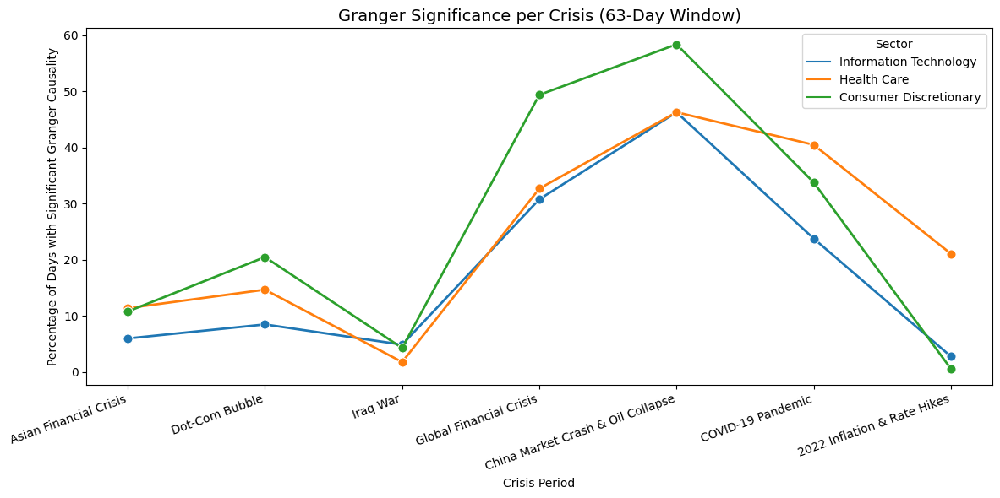

In [ ]:
# Plotting more visually appealing significance timeline across crises

import matplotlib.pyplot as plt
import seaborn as sns

def plot_significance_timeline(sig_df, title="Significance Timeline (p < 0.05)"):
    """
    Plot a timeline of % significant Granger p-values per sector and crisis.
    """
    # Ensure correct order of crises
    crisis_order = sig_df['Crisis'].unique().tolist()
    sig_df['Crisis'] = pd.Categorical(sig_df['Crisis'], categories=crisis_order, ordered=True)

    plt.figure(figsize=(12, 6))
    sns.lineplot(
        data=sig_df,
        x='Crisis',
        y='Significance %',
        hue='Sector',
        marker='o',
        linewidth=2,
        markersize=8
    )

    #plt.axhline(5, color='red', linestyle='--', label='5% Threshold')
    plt.title(title, fontsize=14)
    plt.ylabel("Percentage of Days with Significant Granger Causality")
    plt.xlabel("Crisis Period")
    plt.xticks(rotation=20, ha='right')
    plt.legend(title="Sector")
    plt.grid(False)
    plt.tight_layout()
    plt.show()

    # Create the summary
sig_df_63 = compute_significance_ratio(
    rolling_pvals_df=rolling_joint_pvals[63],
    sectors=sectors,
    crisis_windows=crisis_windows
)

# Plot the timeline
plot_significance_timeline(sig_df_63, title="Granger Significance per Crisis (63-Day Window)")



In [16]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from statsmodels.tsa.api import VAR

def plot_girf_crisis_grid(data, sectors, crisis_subset, title, n_steps=10, max_lag=6, n_repl=300, signif=0.05):
    num_crises = len(crisis_subset)
    fig, axes = plt.subplots(6, num_crises, figsize=(5 * num_crises, 12), sharex=True)
    fig.subplots_adjust(hspace=0.5, wspace=0.3)

    shock_vars = ['WTI Log Daily Change', 'VIX Close']
    x = np.arange(n_steps + 1)
    shock_colors = ['green', 'blue']
    shock_labels = ['WTI Shock', 'VIX Shock']

    # Titles for sector rows
    sector_labels = [s.replace(' Daily Log Return', '') for s in sectors]

    for col, (crisis_name, start, end) in enumerate(crisis_subset):
        for s_idx, sector in enumerate(sectors):
            for shock_row in range(2):  # 0 = WTI, 1 = VIX
                row = s_idx * 2 + shock_row
                ax = axes[row, col] if num_crises > 1 else axes[row]

                try:
                    subset = data.loc[pd.to_datetime(start):pd.to_datetime(end), shock_vars + [sector]].dropna()
                    if len(subset) < (max_lag + n_steps + 1):
                        ax.text(0.5, 0.5, 'Insufficient data', ha='center', va='center')
                        ax.axis('off')
                        continue

                    model = VAR(subset)
                    fitted = model.fit(maxlags=max_lag, ic='bic')
                    irf = fitted.irf(n_steps)
                    lower, upper = irf.errband_mc(orth=False, repl=n_repl, signif=signif)

                    sector_idx = subset.columns.get_loc(sector)
                    shock_idx = shock_row

                    y = irf.irfs[:, sector_idx, shock_idx]
                    y_low = lower[:, sector_idx, shock_idx]
                    y_high = upper[:, sector_idx, shock_idx]

                    ax.plot(x, y, color=shock_colors[shock_row])
                    ax.fill_between(x, y_low, y_high, color=shock_colors[shock_row], alpha=0.2)
                    ax.axhline(0, color='gray', linestyle='--')
                    ax.grid(False)

                    if row == 0:
                        ax.set_title(crisis_name, fontsize=11)
                    if col == 0:
                        ax.set_ylabel("Response", fontsize=10)
                    if row == 5:
                        ax.set_xlabel("Days After Shock")

                except Exception as e:
                    ax.text(0.5, 0.5, 'Error', ha='center', va='center')
                    ax.set_title(f"{crisis_name} (Error)", fontsize=10)
                    ax.axis('off')
                    print(f"Error in {sector} during {crisis_name}: {e}")

    # Add sector subtitles to the left of each 2-row block
    for s_idx, label in enumerate(sector_labels):
        fig.text(0.02, 0.87 - s_idx * 0.285, label, va='center', rotation='vertical', fontsize=12, fontweight='bold')

    # Shared legend
    handles = [
        plt.Line2D([0], [0], color='green', label='WTI Shock'),
        plt.Line2D([0], [0], color='blue', label='VIX Shock')
    ]
    fig.legend(handles=handles, loc='lower center', ncol=2, fontsize=10, bbox_to_anchor=(0.5, -0.015))

    fig.suptitle(title, fontsize=15, y=1.02)
    plt.tight_layout(rect=[0.03, 0.03, 1, 0.97])
    plt.show()


C:\Users\nicol\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\nicol\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\nicol\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g

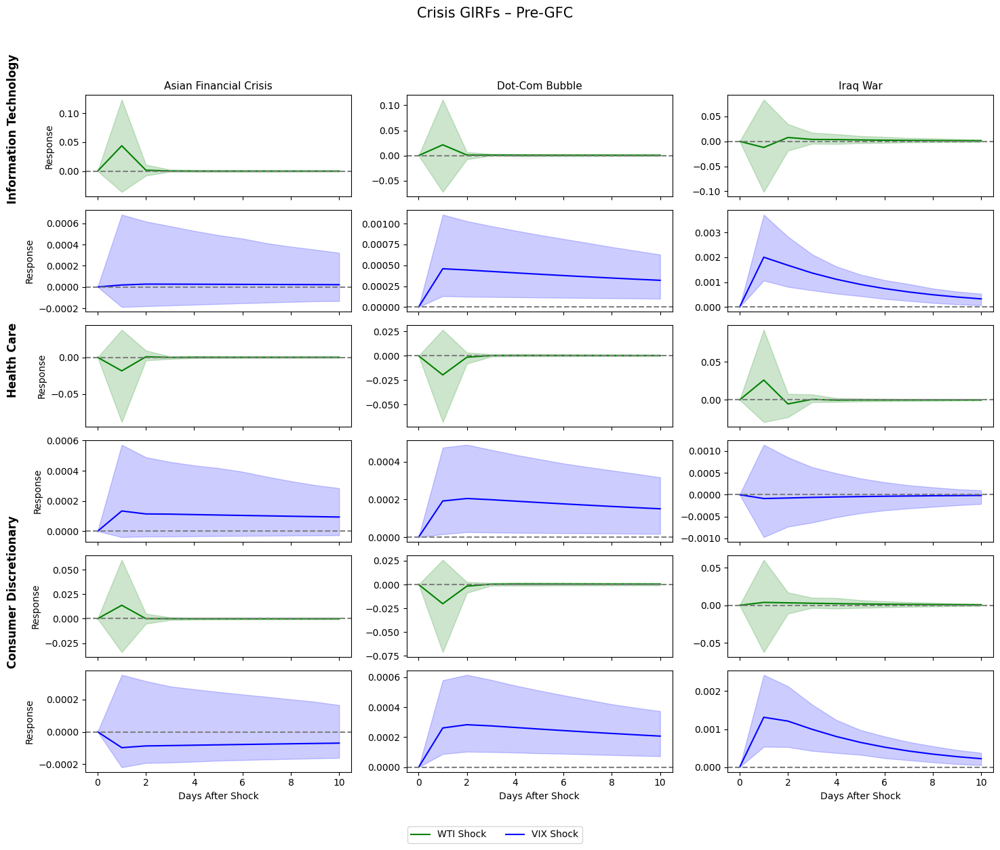

C:\Users\nicol\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\nicol\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\nicol\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g

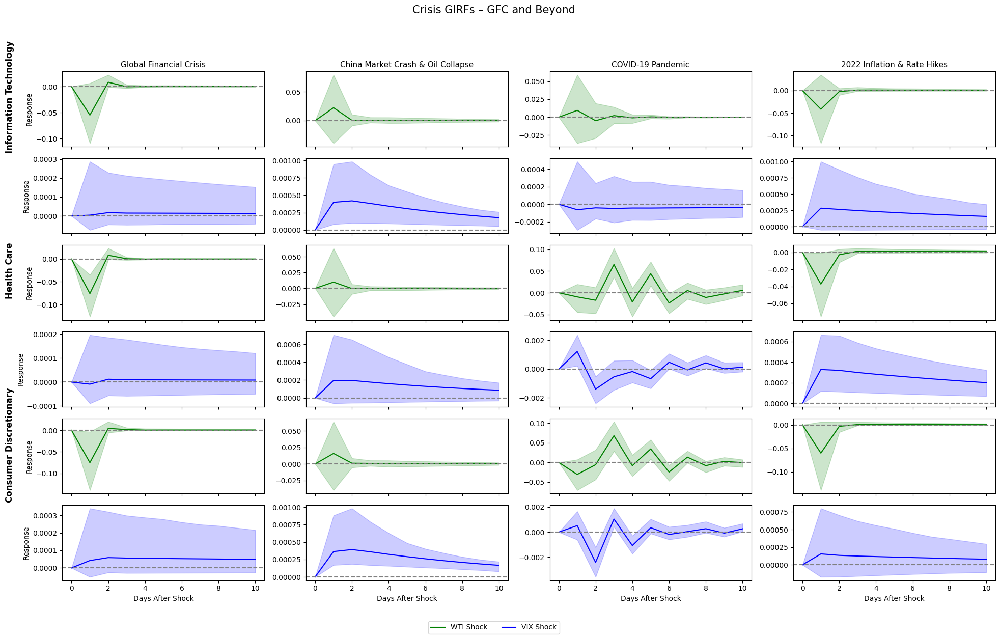

In [17]:
# Crisis split for visualization
pre_gfc = crisis_windows[:3]
post_gfc = crisis_windows[3:]

# Run figure
plot_girf_crisis_grid(data, sectors, pre_gfc, title="Crisis GIRFs – Pre-GFC")
plot_girf_crisis_grid(data, sectors, post_gfc, title="Crisis GIRFs – GFC and Beyond")

### Crisis Zoom in for Return Behavior

#### Extreme Value Theory

Health Care Daily Log Return: Shape = 0.4548, Scale = 0.0067
Information Technology Daily Log Return: Shape = 0.4309, Scale = 0.0095
Consumer Discretionary Daily Log Return: Shape = 0.5180, Scale = 0.0078


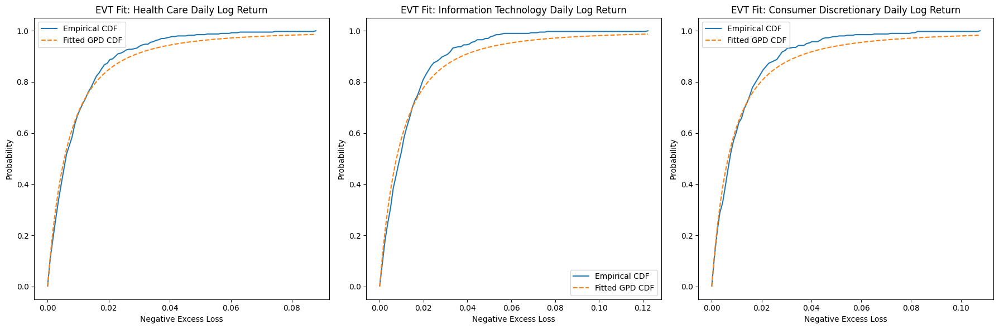

In [ ]:
import numpy as np
import pandas as pd
import scipy.stats as stats
import matplotlib.pyplot as plt
from statsmodels.distributions.empirical_distribution import ECDF
from scipy.stats import genpareto

# Define the sectors
sectors = ['Health Care Daily Log Return', 'Information Technology Daily Log Return', 'Consumer Discretionary Daily Log Return']


# Threshold for POT (e.g., 5th percentile)
thresholds = {sector: np.percentile(data[sector], 5) for sector in sectors}

# Fit GPD for extreme losses in each sector
gpd_params = {}
for sector in sectors:
    excess_losses = data[data[sector] < thresholds[sector]][sector] - thresholds[sector]
    shape, loc, scale = genpareto.fit(-excess_losses)  # Fit GPD
    gpd_params[sector] = {'shape': shape, 'scale': scale}
    print(f"{sector}: Shape = {shape:.4f}, Scale = {scale:.4f}")

# Plot empirical CDF and fitted GPD for each sector
plt.figure(figsize=(18, 6))

for i, sector in enumerate(sectors):
    excess_losses = data[data[sector] < thresholds[sector]][sector] - thresholds[sector]
    ecdf = ECDF(-excess_losses)
    x = np.linspace(min(-excess_losses), max(-excess_losses), 100)
    
    plt.subplot(1, 3, i + 1)
    plt.plot(x, ecdf(x), label='Empirical CDF')
    plt.plot(x, genpareto.cdf(x, *genpareto.fit(-excess_losses)), label='Fitted GPD CDF', linestyle='dashed')
    plt.xlabel("Negative Excess Loss")
    plt.ylabel("Probability")
    plt.title(f"EVT Fit: {sector}")
    plt.legend()

plt.tight_layout()
plt.show()


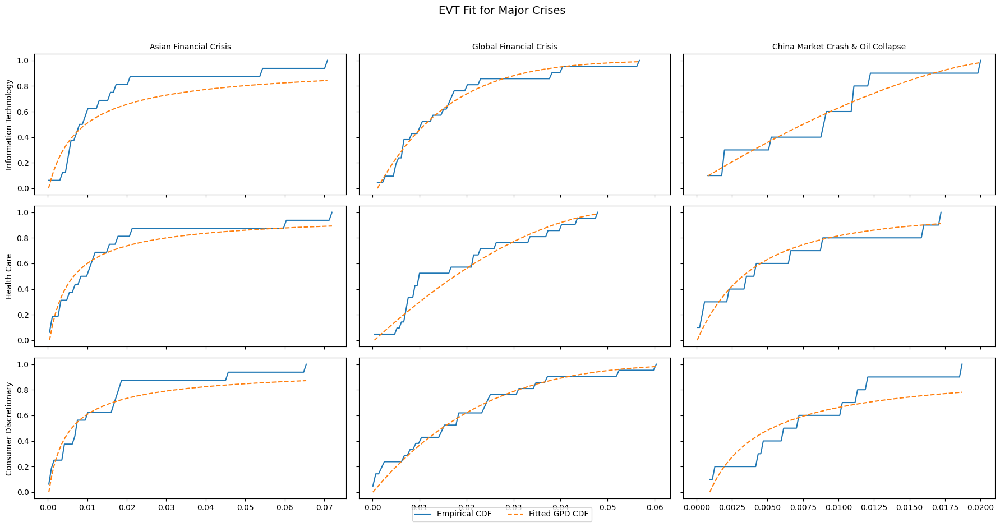

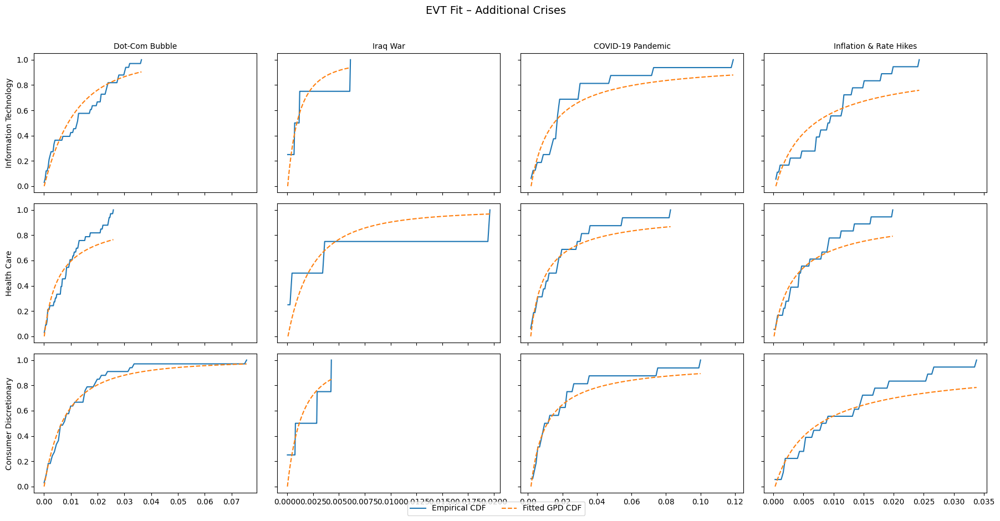

In [20]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.stats import genpareto
from statsmodels.distributions.empirical_distribution import ECDF

# === Configuration ===
sectors = [

    'Information Technology Daily Log Return',
     'Health Care Daily Log Return',
    'Consumer Discretionary Daily Log Return'
]

# === Crisis periods ===
crisis_groups = {
    "Main Crises (3x3)": [
        ("Asian Financial Crisis", "1997-07-01", "1998-10-01"),
        ("Global Financial Crisis", "2007-07-01", "2009-03-01"),
        ("China Market Crash & Oil Collapse", "2015-06-01", "2016-03-01"),
    ],
    "Appendix Crises (4x3)": [
        ("Dot-Com Bubble", "2000-03-01", "2002-10-01"),
        ("Iraq War", "2003-10-01", "2003-12-31"),
        ("COVID-19 Pandemic", "2020-03-01", "2021-06-01"),
        ("Inflation & Rate Hikes", "2022-01-01", "2023-06-01")
    ]
}

# === Function to plot EVT fits ===
def plot_evt_crisis_grid(data, crises, title):
    fig, axes = plt.subplots(len(sectors), len(crises), figsize=(18, 9), sharey='row', sharex='col')
    fig.subplots_adjust(hspace=0.3, wspace=0.3)

    for col, (crisis_name, start, end) in enumerate(crises):
        subset = data.loc[pd.to_datetime(start):pd.to_datetime(end)]

        for row, sector in enumerate(sectors):
            ax = axes[row, col]
            try:
                threshold = np.percentile(subset[sector], 5)
                excess_losses = subset[subset[sector] < threshold][sector] - threshold
                ecdf = ECDF(-excess_losses)
                x = np.linspace(min(-excess_losses), max(-excess_losses), 100)

                # Plot
                ax.plot(x, ecdf(x), label='Empirical CDF')
                ax.plot(x, genpareto.cdf(x, *genpareto.fit(-excess_losses)), 
                        label='Fitted GPD CDF', linestyle='dashed')
                ax.set_title(f"{crisis_name}", fontsize=10) if row == 0 else None
                ax.set_ylabel(sector.replace(" Daily Log Return", ""), fontsize=10) if col == 0 else None
                ax.grid(False)

            except Exception as e:
                ax.set_title(f"{crisis_name} (error)")
                print(f"Error in {sector} - {crisis_name}: {e}")

    handles, labels = axes[0, 0].get_legend_handles_labels()
    fig.legend(handles, labels, loc='lower center', ncol=3, bbox_to_anchor=(0.5, -0.01))
    plt.suptitle(title, fontsize=14, y=1.02)
    plt.tight_layout()
    plt.show()

# === Plot both groups ===
plot_evt_crisis_grid(data, crisis_groups["Main Crises (3x3)"], title="EVT Fit for Major Crises")
plot_evt_crisis_grid(data, crisis_groups["Appendix Crises (4x3)"], title="EVT Fit – Additional Crises")


In [21]:
import numpy as np
import pandas as pd
from scipy.stats import genpareto

# === Define sectors and crisis periods ===
sectors = [
    'Health Care Daily Log Return',
    'Information Technology Daily Log Return',
    'Consumer Discretionary Daily Log Return'
]

crisis_periods = [
    ("Asian Financial Crisis", "1997-07-01", "1998-10-01"),
    ("Global Financial Crisis", "2007-07-01", "2009-03-01"),
    ("China Market Crash & Oil Collapse", "2015-06-01", "2016-03-01"),
    ("Dot-Com Bubble", "2000-03-01", "2002-10-01"),
    ("Iraq War", "2003-10-01", "2003-12-31"),
    ("COVID-19 Pandemic", "2020-03-01", "2021-06-01"),
    ("Inflation & Rate Hikes", "2022-01-01", "2023-06-01")
]

# === Prepare storage ===
evt_params = []

# === Loop through each crisis and sector ===
for crisis_name, start_date, end_date in crisis_periods:
    subset = data.loc[pd.to_datetime(start_date):pd.to_datetime(end_date)]

    for sector in sectors:
        try:
            threshold = np.percentile(subset[sector], 5)
            excess_losses = subset[subset[sector] < threshold][sector] - threshold

            # Fit GPD to negative excess losses
            shape, loc, scale = genpareto.fit(-excess_losses)

            evt_params.append({
                "Crisis": crisis_name,
                "Sector": sector.replace(" Daily Log Return", ""),
                "Shape (ξ)": round(shape, 4),
                "Scale (β)": round(scale, 4),
                "Threshold (5%)": round(threshold, 4)
            })

        except Exception as e:
            evt_params.append({
                "Crisis": crisis_name,
                "Sector": sector.replace(" Daily Log Return", ""),
                "Shape (ξ)": np.nan,
                "Scale (β)": np.nan,
                "Threshold (5%)": np.nan
            })
            print(f"⚠️ Error in {sector} during {crisis_name}: {e}")

# === Convert to DataFrame ===
evt_df = pd.DataFrame(evt_params)

# === Preview (optional) ===
print(evt_df)

# === Optional: save to file
# evt_df.to_csv("evt_gpd_parameters_by_crisis.csv", index=False)


                               Crisis                  Sector  Shape (ξ)  \
0              Asian Financial Crisis             Health Care     1.2965   
1              Asian Financial Crisis  Information Technology     1.3994   
2              Asian Financial Crisis  Consumer Discretionary     1.4973   
3             Global Financial Crisis             Health Care    -0.5786   
4             Global Financial Crisis  Information Technology    -0.0982   
5             Global Financial Crisis  Consumer Discretionary    -0.2233   
6   China Market Crash & Oil Collapse             Health Care     0.4461   
7   China Market Crash & Oil Collapse  Information Technology    -0.6605   
8   China Market Crash & Oil Collapse  Consumer Discretionary     1.2347   
9                      Dot-Com Bubble             Health Care     1.4023   
10                     Dot-Com Bubble  Information Technology     0.2188   
11                     Dot-Com Bubble  Consumer Discretionary     0.5127   
12          

#### CVAR

In [22]:
import numpy as np
import pandas as pd

# === Input (Make sure `data` has datetime index and sector columns) ===
sectors = [
    'Health Care Daily Log Return',
    'Information Technology Daily Log Return',
    'Consumer Discretionary Daily Log Return'
]

crisis_periods = [
    ("Asian Financial Crisis", "1997-07-01", "1998-10-01"),
    ("Global Financial Crisis", "2007-07-01", "2009-03-01"),
    ("China Market Crash & Oil Collapse", "2015-06-01", "2016-03-01"),
    ("Dot-Com Bubble", "2000-03-01", "2002-10-01"),
    ("Iraq War", "2003-10-01", "2003-12-31"),
    ("COVID-19 Pandemic", "2020-03-01", "2021-06-01"),
    ("Inflation & Rate Hikes", "2022-01-01", "2023-06-01")
]

alpha_levels = [0.95, 0.99]

# === Compute CVaR ===
cvar_records = []

for crisis_name, start_date, end_date in crisis_periods:
    subset = data.loc[pd.to_datetime(start_date):pd.to_datetime(end_date)]
    
    for sector in sectors:
        record = {
            'Crisis': crisis_name,
            'Sector': sector.replace(" Daily Log Return", "")
        }
        
        for alpha in alpha_levels:
            try:
                var = np.percentile(subset[sector], 100 * (1 - alpha))
                cvar = subset[subset[sector] < var][sector].mean()
                record[f'CVaR {int(alpha * 100)}%'] = round(cvar, 5)
            except:
                record[f'CVaR {int(alpha * 100)}%'] = np.nan
        
        cvar_records.append(record)

# === Output as DataFrame ===
cvar_df = pd.DataFrame(cvar_records)

# === Optional: Save or display ===
print(cvar_df)
# cvar_df.to_csv("cvar_by_crisis.csv", index=False)


                               Crisis                  Sector  CVaR 95%  \
0              Asian Financial Crisis             Health Care  -0.03515   
1              Asian Financial Crisis  Information Technology  -0.04480   
2              Asian Financial Crisis  Consumer Discretionary  -0.03405   
3             Global Financial Crisis             Health Care  -0.04466   
4             Global Financial Crisis  Information Technology  -0.05520   
5             Global Financial Crisis  Consumer Discretionary  -0.05926   
6   China Market Crash & Oil Collapse             Health Care  -0.02916   
7   China Market Crash & Oil Collapse  Information Technology  -0.03124   
8   China Market Crash & Oil Collapse  Consumer Discretionary  -0.02990   
9                      Dot-Com Bubble             Health Care  -0.03617   
10                     Dot-Com Bubble  Information Technology  -0.06131   
11                     Dot-Com Bubble  Consumer Discretionary  -0.03940   
12                       

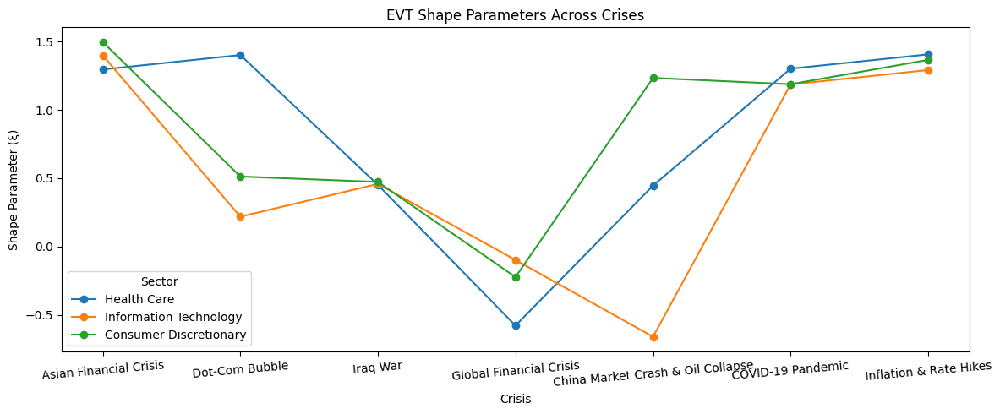

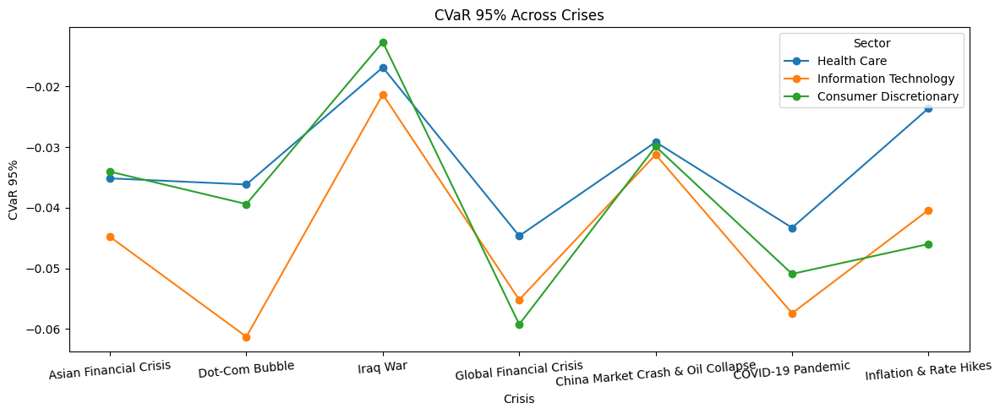

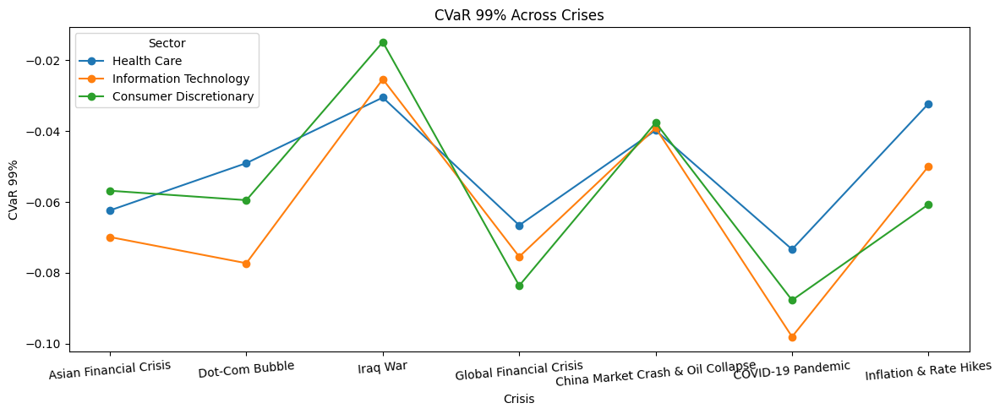

In [ ]:
import matplotlib.pyplot as plt

# === Settings ===
crisis_labels = [
    "Asian Financial Crisis",
    "Dot-Com Bubble",
    "Iraq War",
    "Global Financial Crisis",
    "China Market Crash & Oil Collapse",
    "COVID-19 Pandemic",
    "Inflation & Rate Hikes"
]

sectors = [
    "Health Care",
    "Information Technology",
    "Consumer Discretionary"
]

# === Prepare Data ===

# EVT Shape Parameters (from evt_df)
evt_shape_data = {
    sector: [evt_df[(evt_df['Sector'] == sector) & (evt_df['Crisis'] == crisis)]['Shape (ξ)'].values[0]
             for crisis in crisis_labels]
    for sector in sectors
}

# CVaR 95% and 99% (from cvar_df)
cvar_95_data = {
    sector: [cvar_df[(cvar_df['Sector'] == sector) & (cvar_df['Crisis'] == crisis)]['CVaR 95%'].values[0]
             for crisis in crisis_labels]
    for sector in sectors
}

cvar_99_data = {
    sector: [cvar_df[(cvar_df['Sector'] == sector) & (cvar_df['Crisis'] == crisis)]['CVaR 99%'].values[0]
             for crisis in crisis_labels]
    for sector in sectors
}

# === Plot EVT Shape Parameters ===
plt.figure(figsize=(12, 5))
for sector, shape_vals in evt_shape_data.items():
    plt.plot(crisis_labels, shape_vals, marker='o', label=sector)

plt.xlabel("Crisis")
plt.ylabel("Shape Parameter (ξ)")
plt.title("EVT Shape Parameters Across Crises")
plt.xticks(rotation=5)
plt.grid(False)
plt.legend(title="Sector")
plt.tight_layout()
plt.show()

# === Plot CVaR 95% ===
plt.figure(figsize=(12, 5))
for sector, cvar_vals in cvar_95_data.items():
    plt.plot(crisis_labels, cvar_vals, marker='o', label=sector)

plt.xlabel("Crisis")
plt.ylabel("CVaR 95%")
plt.title("CVaR 95% Across Crises")
plt.xticks(rotation=5)
plt.grid(False)
plt.legend(title="Sector")
plt.tight_layout()
plt.show()

# === Plot CVaR 99% ===
plt.figure(figsize=(12, 5))
for sector, cvar_vals in cvar_99_data.items():
    plt.plot(crisis_labels, cvar_vals, marker='o', label=sector)

plt.xlabel("Crisis")
plt.ylabel("CVaR 99%")
plt.title("CVaR 99% Across Crises")
plt.xticks(rotation=5)
plt.grid(False)
plt.legend(title="Sector")
plt.tight_layout()
plt.show()


#### Return behavior for different oil price changes during the different crises

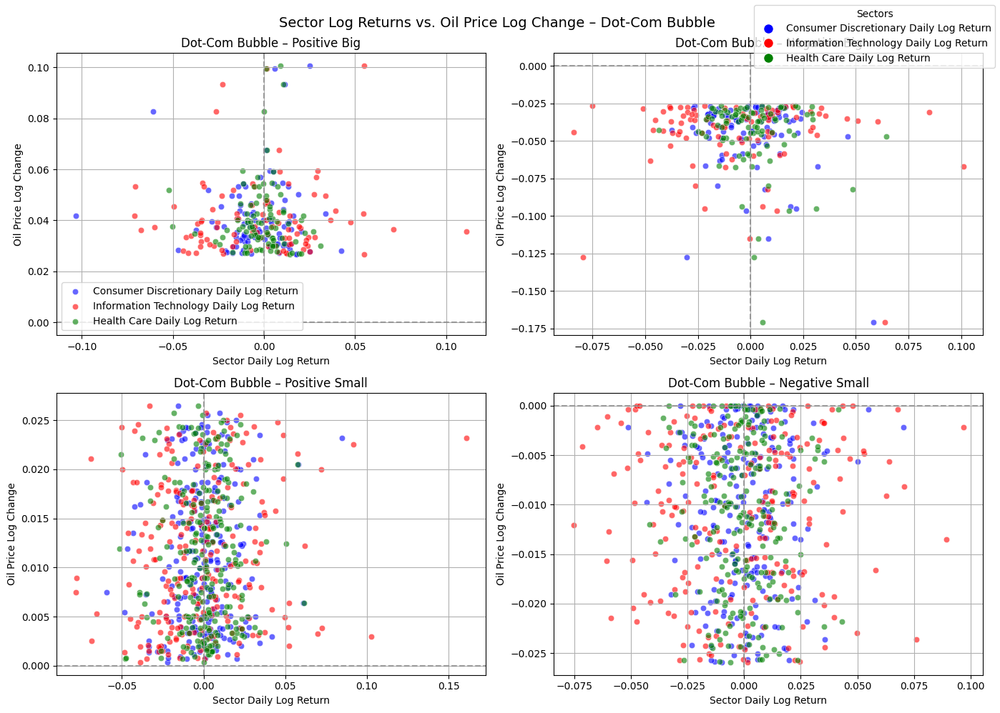

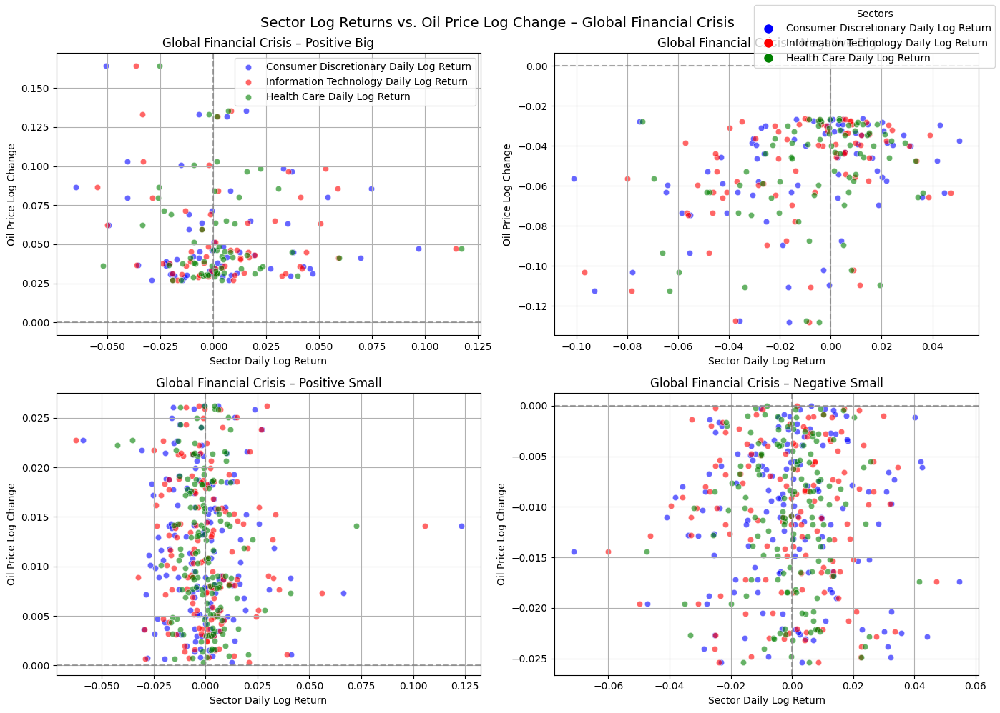

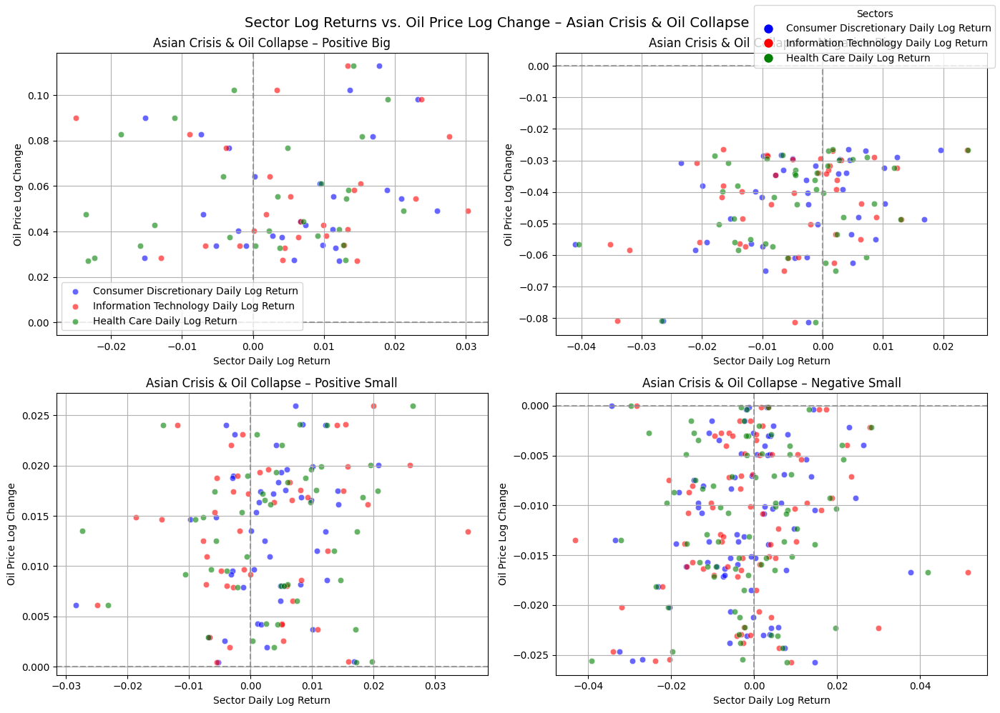

In [25]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Compute mean and standard deviation
mean_wti = data['WTI Log Daily Change'].mean()
std_wti = data['WTI Log Daily Change'].std()

# Define thresholds
data['WTI Change Category'] = pd.cut(
    data['WTI Log Daily Change'],
    bins=[-np.inf, mean_wti - std_wti, 0, mean_wti + std_wti, np.inf],
    labels=['Negative Big', 'Negative Small', 'Positive Small', 'Positive Big']
)


# === Settings ===
sector_features = [
    "Consumer Discretionary Daily Log Return",
    "Information Technology Daily Log Return",
    "Health Care Daily Log Return"
]

oil_change_types = ['Positive Big', 'Negative Big', 'Positive Small', 'Negative Small']

sector_colors = {
    "Consumer Discretionary Daily Log Return": "blue",
    "Information Technology Daily Log Return": "red",
    "Health Care Daily Log Return": "green"
}

# === Crisis periods to examine ===
crisis_periods = {
    "Dot-Com Bubble": ("2000-03-01", "2002-10-01"),
    "Global Financial Crisis": ("2007-07-01", "2009-03-01"),
    "Asian Crisis & Oil Collapse": ("2015-06-01", "2016-03-01")
}

# Ensure datetime index for filtering
data.index = pd.to_datetime(data.index)

# === Plot by crisis period ===
for crisis_name, (start_date, end_date) in crisis_periods.items():
    crisis_data = data.loc[start_date:end_date]

    fig, axes = plt.subplots(2, 2, figsize=(14, 10))
    axes = axes.flatten()

    for i, oil_change in enumerate(oil_change_types):
        subset = crisis_data[crisis_data['WTI Change Category'] == oil_change]

        ax = axes[i]
        for sector in sector_features:
            sns.scatterplot(data=subset, x=sector, y="WTI Log Daily Change",
                            color=sector_colors[sector], alpha=0.6, ax=ax, label=sector if i == 0 else "_nolegend_")

        ax.axvline(x=0, color='gray', linestyle='--', alpha=0.7)
        ax.axhline(y=0, color='gray', linestyle='--', alpha=0.7)
        ax.set_title(f"{crisis_name} – {oil_change}")
        ax.set_xlabel("Sector Daily Log Return")
        ax.set_ylabel("Oil Price Log Change")
        ax.grid(True)

    # Legend
    handles = [
        plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=sector_colors[sector], markersize=10, label=sector)
        for sector in sector_features
    ]
    fig.legend(handles=handles, loc="upper right", title="Sectors")

    plt.suptitle(f"Sector Log Returns vs. Oil Price Log Change – {crisis_name}", fontsize=14)
    plt.tight_layout()
    plt.show()


Not really important, but may come in handy.

#### Statistical Tests for Comparison

In [27]:
import numpy as np
import pandas as pd
from scipy import stats

# === SETTINGS ===
sector_features = [
    "Consumer Discretionary Daily Log Return",
    "Information Technology Daily Log Return",
    "Health Care Daily Log Return"
]

categories = ['Positive Big', 'Negative Big', 'Positive Small', 'Negative Small']

crisis_periods = {
    "Dot-Com Bubble": ("2000-03-01", "2002-10-01"),
    "Global Financial Crisis": ("2007-07-01", "2009-03-01"),
    "Asian Crisis & Oil Collapse": ("2015-06-01", "2016-03-01"),
    "COVID-19 Pandemic": ("2020-03-01", "2021-06-01"),
    "Inflation & Rate Hikes": ("2022-01-01", "2023-06-01")
}

# === Boostrap FUNCTION ===
def bootstrap_ci(data, n_bootstrap=1000, ci=95):
    boot_means = np.random.choice(data, (n_bootstrap, len(data)), replace=True).mean(axis=1)
    lower_bound = np.percentile(boot_means, (100 - ci) / 2)
    upper_bound = np.percentile(boot_means, 100 - (100 - ci) / 2)
    return lower_bound, upper_bound

# === CONTAINERS FOR RESULTS ===
kruskal_results = []
mannwhitney_results = []
bootstrap_results = []

# === RUN ANALYSIS FOR EACH CRISIS & CATEGORY ===
for crisis_name, (start, end) in crisis_periods.items():
    crisis_data = data.loc[start:end]

    for cat in categories:
        subset = crisis_data[crisis_data['WTI Change Category'] == cat]

        # --- Kruskal-Wallis ---
        kruskal_stat, kruskal_p = stats.kruskal(
            subset[sector_features[0]],
            subset[sector_features[1]],
            subset[sector_features[2]]
        )
        kruskal_results.append({
            "Crisis": crisis_name,
            "WTI Category": cat,
            "Kruskal p-value": kruskal_p
        })

        # --- Mann-Whitney U Tests ---
        u_hc_it, p_hc_it = stats.mannwhitneyu(subset[sector_features[2]], subset[sector_features[1]])
        u_hc_cd, p_hc_cd = stats.mannwhitneyu(subset[sector_features[2]], subset[sector_features[0]])
        u_it_cd, p_it_cd = stats.mannwhitneyu(subset[sector_features[1]], subset[sector_features[0]])

        mannwhitney_results.extend([
            {"Crisis": crisis_name, "WTI Category": cat, "Pair": "Health Care vs IT", "p-value": p_hc_it},
            {"Crisis": crisis_name, "WTI Category": cat, "Pair": "Health Care vs CD", "p-value": p_hc_cd},
            {"Crisis": crisis_name, "WTI Category": cat, "Pair": "IT vs CD", "p-value": p_it_cd}
        ])

        # --- Bootstrap Confidence Intervals ---
        for sector in sector_features:
            values = subset[sector].dropna().values
            if len(values) > 0:
                mean_val = np.mean(values)
                lower, upper = bootstrap_ci(values)
                bootstrap_results.append({
                    "Crisis": crisis_name,
                    "WTI Category": cat,
                    "Sector": sector.replace(" Daily Log Return", ""),
                    "Mean": mean_val,
                    "CI Lower": lower,
                    "CI Upper": upper
                })

# === CREATE AND EXPORT DATAFRAMES ===
kruskal_df = pd.DataFrame(kruskal_results)
mannwhitney_df = pd.DataFrame(mannwhitney_results)
bootstrap_df = pd.DataFrame(bootstrap_results)

# === OPTIONAL: Display or Save to CSV ===
print("\n=== Kruskal-Wallis p-values ===")
print(kruskal_df)

print("\n=== Mann-Whitney U Test p-values ===")
print(mannwhitney_df)

print("\n=== Bootstrap Means and Confidence Intervals ===")
print(bootstrap_df)

# To save to CSV:
# kruskal_df.to_csv("kruskal_results.csv", index=False)
# mannwhitney_df.to_csv("mannwhitney_results.csv", index=False)
# bootstrap_df.to_csv("bootstrap_means_ci.csv", index=False)



=== Kruskal-Wallis p-values ===
                         Crisis    WTI Category  Kruskal p-value
0                Dot-Com Bubble    Positive Big         0.771305
1                Dot-Com Bubble    Negative Big         0.060995
2                Dot-Com Bubble  Positive Small         0.106155
3                Dot-Com Bubble  Negative Small         0.732954
4       Global Financial Crisis    Positive Big         0.766606
5       Global Financial Crisis    Negative Big         0.591817
6       Global Financial Crisis  Positive Small         0.295842
7       Global Financial Crisis  Negative Small         0.878847
8   Asian Crisis & Oil Collapse    Positive Big         0.400817
9   Asian Crisis & Oil Collapse    Negative Big         0.814769
10  Asian Crisis & Oil Collapse  Positive Small         0.649418
11  Asian Crisis & Oil Collapse  Negative Small         0.990377
12            COVID-19 Pandemic    Positive Big         0.556147
13            COVID-19 Pandemic    Negative Big         0

Kruskal p-values to detect any differences across WTI types.

Mann-Whitney U p-values to pinpoint which types differ.

In [32]:
from itertools import combinations
from scipy.stats import kruskal, mannwhitneyu

# Prepare containers
within_sector_kruskal = []
within_sector_pairwise = []

# All pairwise combinations of WTI categories
category_pairs = list(combinations(categories, 2))

# Iterate through crisis and sector
for crisis_name, (start, end) in crisis_periods.items():
    crisis_data = data.loc[start:end]

    for sector in sector_features:
        sector_label = sector.replace(" Daily Log Return", "")

        # Prepare data grouped by WTI Category
        grouped = {cat: crisis_data[crisis_data['WTI Change Category'] == cat][sector].dropna() for cat in categories}

        # --- Kruskal-Wallis test ---
        if all(len(grouped[cat]) > 0 for cat in categories):
            h_stat, p_val = kruskal(*[grouped[cat] for cat in categories])
            within_sector_kruskal.append({
                "Crisis": crisis_name,
                "Sector": sector_label,
                "Kruskal p-value": p_val
            })

        # --- Pairwise Mann-Whitney U Tests ---
        for cat1, cat2 in category_pairs:
            if len(grouped[cat1]) > 0 and len(grouped[cat2]) > 0:
                u_stat, p_pair = mannwhitneyu(grouped[cat1], grouped[cat2])
                within_sector_pairwise.append({
                    "Crisis": crisis_name,
                    "Sector": sector_label,
                    "Comparison": f"{cat1} vs. {cat2}",
                    "p-value": p_pair
                })

# Convert to DataFrames
within_sector_kruskal_df = pd.DataFrame(within_sector_kruskal)
within_sector_pairwise_df = pd.DataFrame(within_sector_pairwise)

# Display results
print("=== Kruskal-Wallis (Across WTI Categories) ===")
print(within_sector_kruskal_df)

print("\n=== Pairwise Mann-Whitney U (Across WTI Categories) ===")
print(within_sector_pairwise_df)

# Optional export
within_sector_kruskal_df.to_csv("sector_kruskal_by_crisis.csv", index=False)
within_sector_pairwise_df.to_csv("sector_pairwise_u_by_crisis.csv", index=False)


=== Kruskal-Wallis (Across WTI Categories) ===
                         Crisis                  Sector  Kruskal p-value
0                Dot-Com Bubble  Consumer Discretionary         0.663707
1                Dot-Com Bubble  Information Technology         0.558000
2                Dot-Com Bubble             Health Care         0.474284
3       Global Financial Crisis  Consumer Discretionary         0.396286
4       Global Financial Crisis  Information Technology         0.022749
5       Global Financial Crisis             Health Care         0.642575
6   Asian Crisis & Oil Collapse  Consumer Discretionary         0.000205
7   Asian Crisis & Oil Collapse  Information Technology         0.000331
8   Asian Crisis & Oil Collapse             Health Care         0.003045
9             COVID-19 Pandemic  Consumer Discretionary         0.029600
10            COVID-19 Pandemic  Information Technology         0.022074
11            COVID-19 Pandemic             Health Care         0.005330
12  